In [1]:
import numpy as np
import pandas as pd
import os
import re
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator, FormatStrFormatter, PercentFormatter
from IPython.display import clear_output
import seaborn as sns
from concurrent.futures import ThreadPoolExecutor
from tqdm import tqdm
from scipy.optimize import minimize

from sklearn.base import clone
from sklearn.metrics import cohen_kappa_score
from sklearn.preprocessing import StandardScaler    
from sklearn.ensemble import VotingRegressor, RandomForestRegressor, GradientBoostingRegressor
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import StratifiedKFold

from keras.models import Model
from keras.layers import Input, Dense
from keras.optimizers import Adam

from xgboost import XGBRegressor
from catboost import CatBoostRegressor
from lightgbm import LGBMRegressor

import torch
import torch.nn as nn
import torch.optim as optim

import warnings
warnings.filterwarnings('ignore')

# Importing and Exploring Datasets

In [254]:
test_data = pd.read_csv("test.csv")
train_data = pd.read_csv("train.csv")

In [256]:
test_id = test_data["id"]

## Exploratory Data Analysis on Train and Test dataframes

In [ ]:
test_data.info()

In [ ]:
train_data.info()

In [ ]:
train_data['sii'].notnull().sum()

In [ ]:
target = "sii"

In [ ]:
test_data

In [ ]:
train_data[train_data['sii'].notnull()] #returns the columns in which the target is not null

In [ ]:
train_data[train_data['Basic_Demos-Enroll_Season'] == "Summer"]

In [140]:
train_data.describe(include = "O")

,id,Basic_Demos-Enroll_Season,CGAS-Season,Physical-Season,Fitness_Endurance-Season,FGC-Season,BIA-Season,PAQ_A-Season,PAQ_C-Season,PCIAT-Season,SDS-Season,PreInt_EduHx-Season
count,3960,3960,2555,3310,1308,3346,2145,475,1721,2736,2618,3540
unique,3960,4,4,4,4,4,4,4,4,4,4,4
top,00008ff9,Spring,Spring,Spring,Spring,Spring,Summer,Winter,Spring,Spring,Spring,Spring
freq,1,1127,697,929,385,993,669,137,506,762,712,985


In [141]:
%config InlineBackend.figure_format = 'retina'

In [142]:
import sys
sys.path.append(r"C:\Users\TESTER\OneDrive\Documentos\GitHub\Projects_Zone")


In [143]:
import utils as u

(2736, 82)


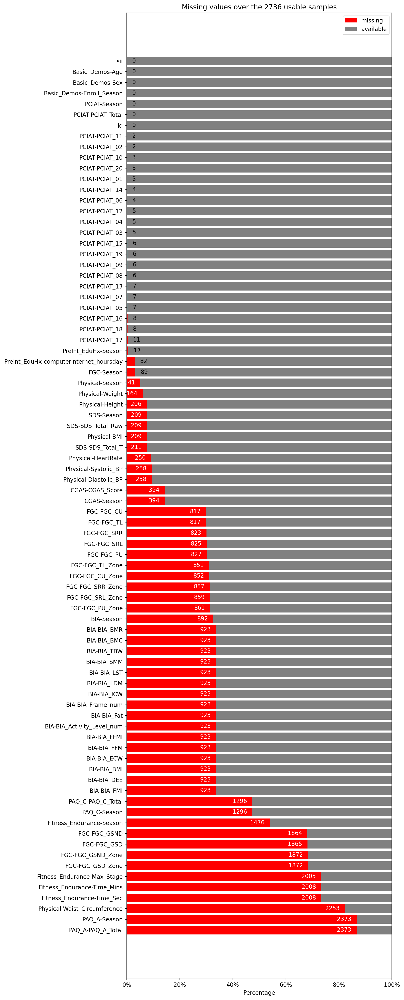

In [144]:
u.missing_values_plot(train_data, "sii")

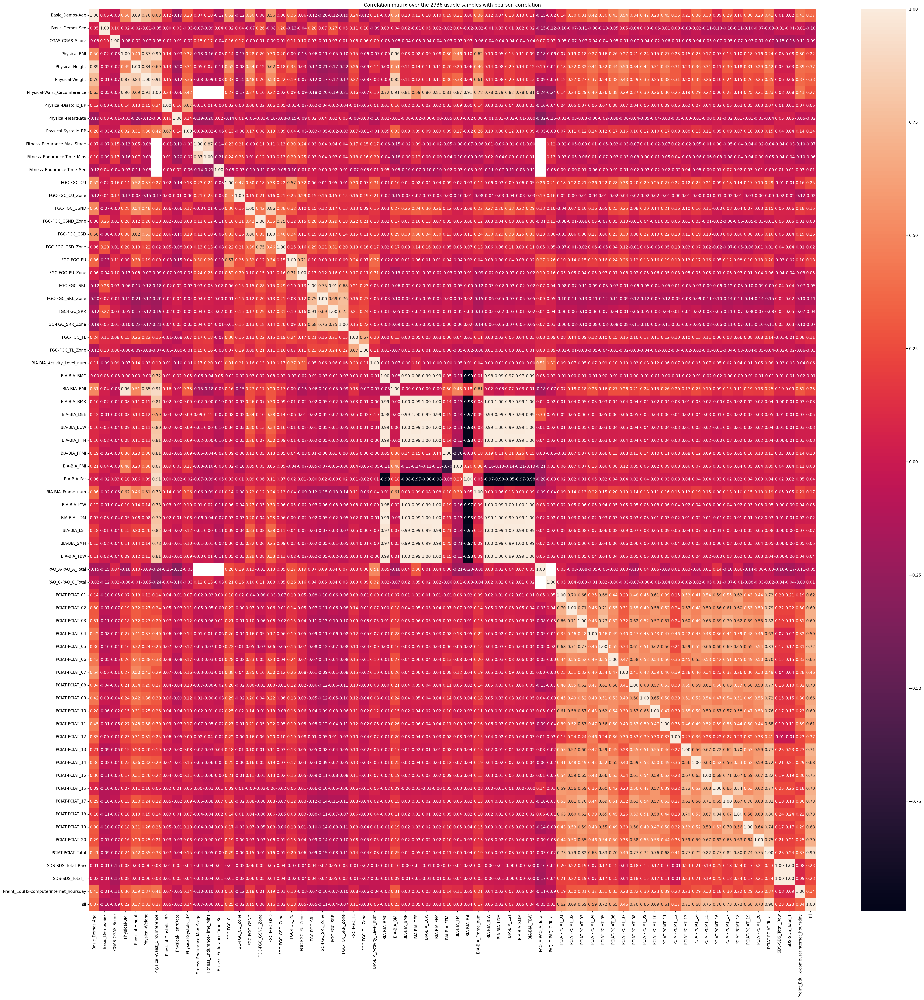

In [145]:
u.plot_correlation_matrix(train_data, "sii")

In [146]:
train_data

,id,Basic_Demos-Enroll_Season,Basic_Demos-Age,Basic_Demos-Sex,CGAS-Season,CGAS-CGAS_Score,Physical-Season,Physical-BMI,Physical-Height,Physical-Weight,...,PCIAT-PCIAT_18,PCIAT-PCIAT_19,PCIAT-PCIAT_20,PCIAT-PCIAT_Total,SDS-Season,SDS-SDS_Total_Raw,SDS-SDS_Total_T,PreInt_EduHx-Season,PreInt_EduHx-computerinternet_hoursday,sii
0,00008ff9,Fall,5,0,Winter,51.0,Fall,16.877316,46.0,50.8,...,4.0,2.0,4.0,55.0,NaN,NaN,NaN,Fall,3.0,2.0
1,000fd460,Summer,9,0,NaN,NaN,Fall,14.035590,48.0,46.0,...,0.0,0.0,0.0,0.0,Fall,46.0,64.0,Summer,0.0,0.0
2,00105258,Summer,10,1,Fall,71.0,Fall,16.648696,56.5,75.6,...,2.0,1.0,1.0,28.0,Fall,38.0,54.0,Summer,2.0,0.0
3,00115b9f,Winter,9,0,Fall,71.0,Summer,18.292347,56.0,81.6,...,3.0,4.0,1.0,44.0,Summer,31.0,45.0,Winter,0.0,1.0
4,0016bb22,Spring,18,1,Summer,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3955,ff8a2de4,Fall,13,0,Spring,60.0,Fall,16.362460,59.5,82.4,...,1.0,1.0,0.0,32.0,Winter,35.0,50.0,Fall,1.0,1.0
3956,ffa9794a,Winter,10,0,NaN,NaN,Spring,18.764678,53.5,76.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Winter,0.0,NaN
3957,ffcd4dbd,Fall,11,0,Spring,68.0,Winter,21.441500,60.0,109.8,...,1.0,0.0,1.0,31.0,Winter,56.0,77.0,Fall,0.0,1.0
3958,ffed1dd5,Spring,13,0,Spring,70.0,Winter,12.235895,70.7,87.0,...,1.0,1.0,1.0,19.0,Spring,33.0,47.0,Spring,1.0,0.0


In [147]:
u.histplot_all(train_data, target = "sii", hue = True, log_scale = True)

From here we can observe that are clear distinct values for the numerical features on instances with the different classes, displayed by the distributions on the histograms

In [149]:
u.violinplot_all(train_data, "sii")

In [150]:
train_data["Basic_Demos-Sex"].value_counts #0 is male 1 is female

<bound method IndexOpsMixin.value_counts of 0       0
1       0
2       1
3       0
4       1
       ..
3955    0
3956    0
3957    0
3958    0
3959    0
Name: Basic_Demos-Sex, Length: 3960, dtype: int64>

Boxplot to see the outliers and quartile divisions for different features accross the different classes, might help distinguish which features are more discernible

In [152]:
u.boxplot_all(train_data, target = "sii", hue = True)

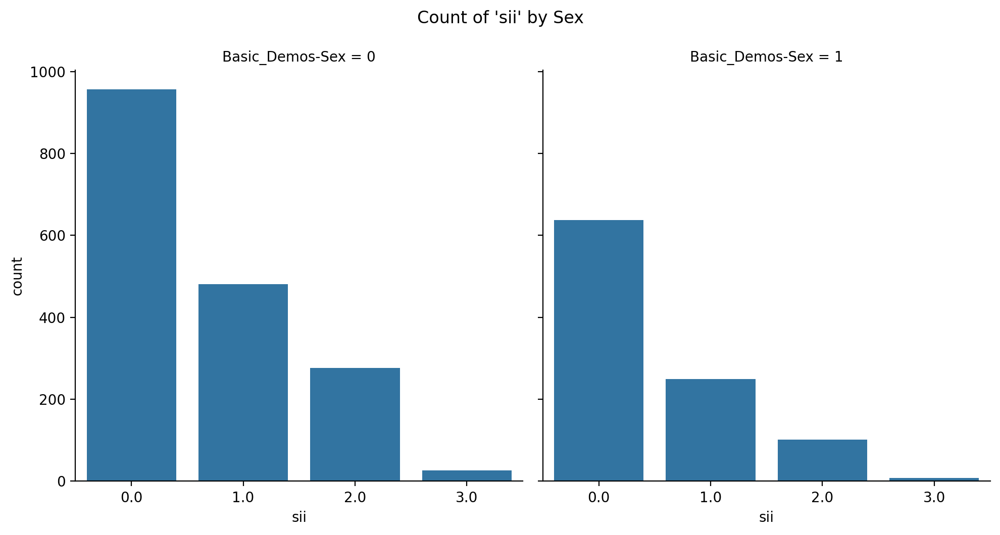

In [153]:
g = sns.FacetGrid(train_data, col="Basic_Demos-Sex", height=5, aspect=1)
g.map(sns.countplot, "sii")

g.fig.suptitle("Count of 'sii' by Sex", y=1.05)
plt.show()

## Visualizing series data

In [155]:
time_series_1 = pd.read_parquet(r"C:\Users\TESTER\OneDrive\Ambiente de Trabalho\kaggle competition\series_train.parquet\id=00f332d1")

In [156]:
time_series_1

,step,X,Y,Z,enmo,anglez,non-wear_flag,light,battery_voltage,time_of_day,weekday,quarter,relative_date_PCIAT
0,0,-0.051997,0.011325,-0.991420,0.026643,-86.152954,0.0,30.000000,4185.000000,57240000000000,1,2,14.0
1,1,-0.008801,-0.036264,-1.000591,0.001868,-87.851646,0.0,30.000000,4185.000000,57245000000000,1,2,14.0
2,2,-0.008904,-0.035101,-1.000357,0.001776,-87.853790,0.0,30.333334,4185.000000,57250000000000,1,2,14.0
3,3,-0.009110,-0.035204,-1.000435,0.001675,-87.850815,0.0,30.666666,4185.000000,57255000000000,1,2,14.0
4,4,-0.009020,-0.035204,-1.000709,0.001846,-87.850815,0.0,31.000000,4185.000000,57260000000000,1,2,14.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
414379,414379,0.015927,-0.021750,-0.985415,0.000000,-88.438774,1.0,0.500000,3098.833252,55535000000000,4,2,38.0
414380,414380,0.016043,-0.021879,-0.985102,0.000000,-88.445999,1.0,0.500000,3098.666748,55540000000000,4,2,38.0
414381,414381,0.015888,-0.021814,-0.985428,0.000000,-88.451225,1.0,0.500000,3098.500000,55545000000000,4,2,38.0
414382,414382,0.016352,-0.021762,-0.985741,0.000000,-88.456245,1.0,0.500000,3098.333252,55550000000000,4,2,38.0


The following functions help visualize the time series data, by converting each entry (file) into various plots divided by feature and observations

Total activity (norm): 200098.296875
Average activity (norm): 0.9375666975975037


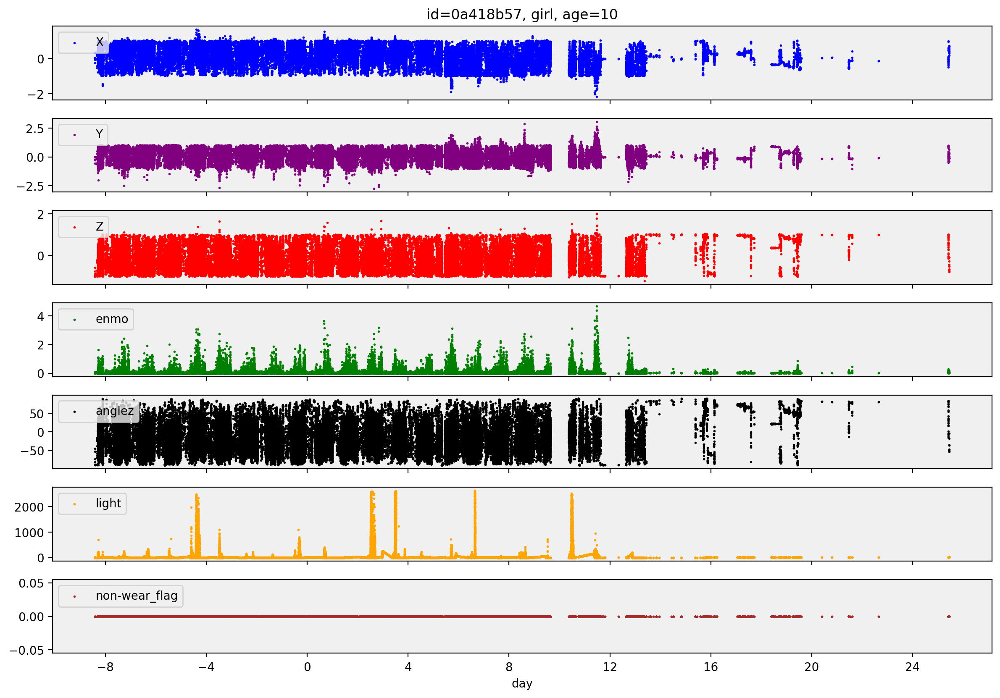

In [158]:
def time_series_visualization(id, only_one_week=True, small=False):
    actigraphy = pd.read_parquet(rf'C:\Users\TESTER\OneDrive\Ambiente de Trabalho\kaggle competition\series_train.parquet\id={id}\part-0.parquet')
    day = actigraphy['relative_date_PCIAT'] + actigraphy['time_of_day'] / 86400e9
    sample = train_data[train_data['id'] == id]
    age = sample['Basic_Demos-Age'].item()
    sex = ['boy', 'girl'][sample['Basic_Demos-Sex'].item()]
    actigraphy['diff_seconds'] = day.diff() * 86400
    actigraphy['norm'] = np.sqrt(actigraphy['X']**2 + actigraphy['Y']**2 + actigraphy['Z']**2)

    if only_one_week:
        start = np.ceil(day.min())
        mask = (start <= day.to_numpy()) & (day.to_numpy() <= start + 7*3)
        mask &= ~actigraphy['non-wear_flag'].astype(bool).to_numpy()
    else:
        mask = np.full(len(day), True)

    if small:
        timelines = [
            ('enmo', 'green'),
            ('light', 'orange'),
        ]
    else:
        timelines = [
            ('X', 'blue'),
            ('Y', 'purple'),
            ('Z', 'red'),
            ('enmo', 'green'),
            ('anglez', 'black'),
            ('light', 'orange'),
            ('non-wear_flag', 'brown')
        ]

    _, axs = plt.subplots(len(timelines), 1, sharex=True, figsize=(12, len(timelines) * 1.1 + 0.5))
    for ax, (feature, color) in zip(axs, timelines):
        ax.set_facecolor('#f0f0f0')
        ax.scatter(day.to_numpy()[mask],
                   actigraphy[feature].to_numpy()[mask],
                   color=color, label=feature, s=1)
        ax.legend(loc='upper left', facecolor='#f0f0f0')
        if feature == 'diff_seconds':
            ax.set_ylim(-0.5, 20.5)
    
    axs[-1].set_xlabel('day')
    axs[-1].xaxis.set_major_locator(MaxNLocator(integer=True))
    plt.tight_layout()
    axs[0].set_title(f'id={id}, {sex}, age={age}')
    
    total_activity = actigraphy['norm'].sum()
    avg_activity = actigraphy['norm'].mean()
    print(f'Total activity (norm): {total_activity}')
    print(f'Average activity (norm): {avg_activity}')
    
    plt.show()

time_series_visualization('0a418b57', only_one_week=False)

Total activity (norm): 266758.78125
Average activity (norm): 0.9288937449455261


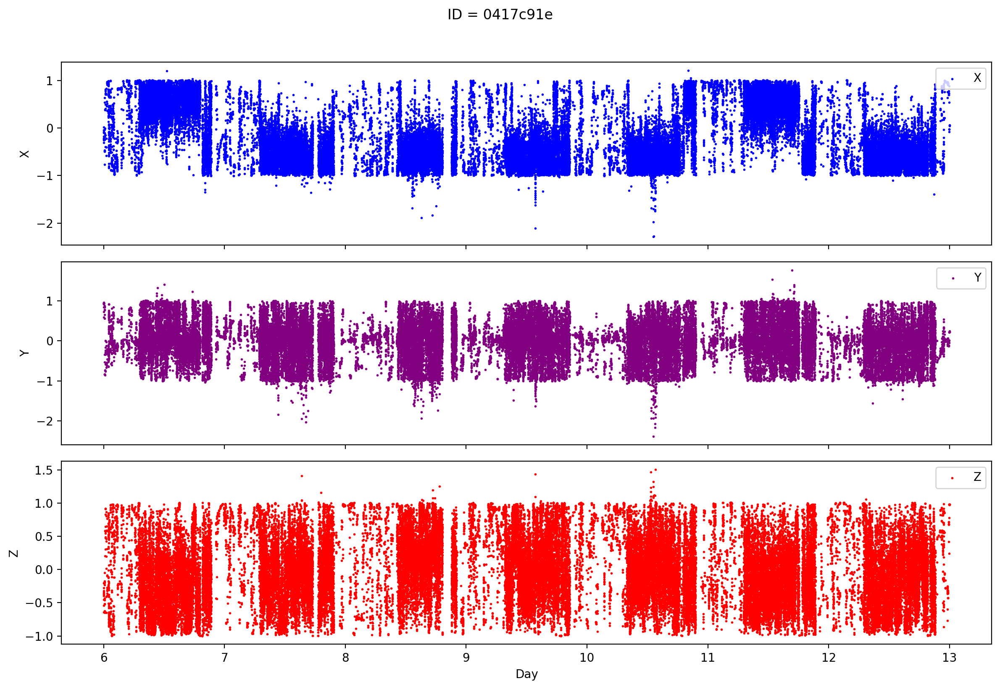

In [159]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def simple_time_series_visualization_separate(id, only_one_week=False):
    # Load the data for the specified ID
    actigraphy = pd.read_parquet(rf'C:\Users\TESTER\OneDrive\Ambiente de Trabalho\kaggle competition\series_train.parquet\id={id}\part-0.parquet')
    
    # Calculate 'day' and 'norm' for plotting
    day = actigraphy['relative_date_PCIAT'] + actigraphy['time_of_day'] / 86400e9
    actigraphy['norm'] = np.sqrt(actigraphy['X']**2 + actigraphy['Y']**2 + actigraphy['Z']**2)
    
    # Apply mask if only_one_week is specified
    if only_one_week:
        start = np.ceil(day.min())
        mask = (start <= day) & (day <= start + 7)
    else:
        mask = np.full(len(day), True)
    
    # List of features and colors for individual subplots
    features = [('X', 'blue'), ('Y', 'purple'), ('Z', 'red')]
    
    # Set up separate subplots for each feature
    fig, axs = plt.subplots(len(features), 1, sharex=True, figsize=(12, 8))
    for ax, (feature, color) in zip(axs, features):
        ax.scatter(day[mask], actigraphy[feature][mask], color=color, label=feature, s=1)
        ax.set_ylabel(feature)
        ax.legend(loc='upper right')
    
    axs[-1].set_xlabel("Day")
    plt.suptitle(f"ID = {id}", y=1.02)
    plt.tight_layout()

    # Show total and average activity for the 'norm' feature
    total_activity = actigraphy['norm'].sum()
    avg_activity = actigraphy['norm'].mean()
    print(f"Total activity (norm): {total_activity}")
    print(f"Average activity (norm): {avg_activity}")
    
    plt.show()

# Example usage
simple_time_series_visualization_separate('0417c91e', only_one_week=True)


## Importing and Processing Time Series parquet files

In [161]:
import pandas as pd
import os
from concurrent.futures import ThreadPoolExecutor
from tqdm import tqdm

features = ['X', 'Y', 'Z', 'enmo', 'anglez', 'non-wear_flag', 
    'light', 'battery_voltage', 'time_of_day', 'weekday', 
    'quarter', 'relative_date_PCIAT']

stats = ['count', 'mean', 'std', 'min', '25%', '50%', '75%', 'max']

column_names = [f"{feature}_{stat}" for feature in features for stat in stats] #this is used down in load_time_series 

def process(filename, directory):

    df = pd.read_parquet(os.path.join(directory, filename, 'part-0.parquet'))
    df.drop('step', axis=1, inplace=True)
    
    return df.describe().values.reshape(-1), filename.split('=')[1]

def load_time_series(dirname) -> pd.DataFrame: #returns a dataframe and loads it
    # Get list of file names in the directory
    idx = os.listdir(dirname)
    
    # Process each file in parallel and collect the results
    with ThreadPoolExecutor() as executor:
        data = list(tqdm(executor.map(lambda x: process(x, dirname), idx), total=len(idx)))
    
    #Handling the separation by index
    stats, indexes = zip(*data)
    
    # Create a DataFrame with meaningful column names
    df = pd.DataFrame(stats, columns=column_names)
    df['id'] = indexes
    return df


In [162]:
train_ts = load_time_series(r'C:\Users\TESTER\OneDrive\Ambiente de Trabalho\kaggle competition\series_train.parquet')
test_ts = load_time_series(r'C:\Users\TESTER\OneDrive\Ambiente de Trabalho\kaggle competition\series_test.parquet')

100%|██████████| 2/2 [00:00<00:00, 11.86it/s]


In [163]:
train_ts.head()

,X_count,X_mean,X_std,X_min,X_25%,X_50%,X_75%,X_max,Y_count,Y_mean,...,quarter_max,relative_date_PCIAT_count,relative_date_PCIAT_mean,relative_date_PCIAT_std,relative_date_PCIAT_min,relative_date_PCIAT_25%,relative_date_PCIAT_50%,relative_date_PCIAT_75%,relative_date_PCIAT_max,id
0,43330.0,43330.0,43330.0,43330.0,43330.0,43330.0,43330.0,43330.0,43330.0,43330.0,...,4.004276,89.751656,0.0,2633.250000,4188.5,8.611000e+13,7.0,3.0,85.0,00115b9f
1,396396.0,396396.0,396396.0,396396.0,396396.0,396396.0,396396.0,396396.0,396396.0,396396.0,...,2.952888,89.476036,1.0,2597.800049,4175.0,8.639500e+13,7.0,3.0,91.0,001f3379
2,414384.0,414384.0,414384.0,414384.0,414384.0,414384.0,414384.0,414384.0,414384.0,414384.0,...,4.041167,89.862823,1.0,2611.000000,4187.0,8.639500e+13,7.0,2.0,38.0,00f332d1
3,370956.0,370956.0,370956.0,370956.0,370956.0,370956.0,370956.0,370956.0,370956.0,370956.0,...,4.097965,88.478432,1.0,2650.500000,4184.0,8.639500e+13,7.0,4.0,61.0,01085eb3
4,97048.0,97048.0,97048.0,97048.0,97048.0,97048.0,97048.0,97048.0,97048.0,97048.0,...,6.307294,88.389679,0.0,2618.000000,4157.0,8.639500e+13,7.0,4.0,2.0,012cadd8


This dataset is filled with float32 type features (996 rows accross 97 columns ((id + 8x12))

In [165]:
test_data = pd.read_csv("test.csv")
train_data = pd.read_csv("train.csv")

In [166]:
train_ts.head() 

,X_count,X_mean,X_std,X_min,X_25%,X_50%,X_75%,X_max,Y_count,Y_mean,...,quarter_max,relative_date_PCIAT_count,relative_date_PCIAT_mean,relative_date_PCIAT_std,relative_date_PCIAT_min,relative_date_PCIAT_25%,relative_date_PCIAT_50%,relative_date_PCIAT_75%,relative_date_PCIAT_max,id
0,43330.0,43330.0,43330.0,43330.0,43330.0,43330.0,43330.0,43330.0,43330.0,43330.0,...,4.004276,89.751656,0.0,2633.250000,4188.5,8.611000e+13,7.0,3.0,85.0,00115b9f
1,396396.0,396396.0,396396.0,396396.0,396396.0,396396.0,396396.0,396396.0,396396.0,396396.0,...,2.952888,89.476036,1.0,2597.800049,4175.0,8.639500e+13,7.0,3.0,91.0,001f3379
2,414384.0,414384.0,414384.0,414384.0,414384.0,414384.0,414384.0,414384.0,414384.0,414384.0,...,4.041167,89.862823,1.0,2611.000000,4187.0,8.639500e+13,7.0,2.0,38.0,00f332d1
3,370956.0,370956.0,370956.0,370956.0,370956.0,370956.0,370956.0,370956.0,370956.0,370956.0,...,4.097965,88.478432,1.0,2650.500000,4184.0,8.639500e+13,7.0,4.0,61.0,01085eb3
4,97048.0,97048.0,97048.0,97048.0,97048.0,97048.0,97048.0,97048.0,97048.0,97048.0,...,6.307294,88.389679,0.0,2618.000000,4157.0,8.639500e+13,7.0,4.0,2.0,012cadd8


<b> We may use pandas .intersection to filter out the columns off of train which don't exist in test and then order the columns correctly<b>

In [168]:
common_cols = train_data.columns.intersection(test_data.columns)
columns_to_keep = common_cols.union(['sii'])

In [169]:
train_data = train_data[columns_to_keep]

In [170]:
train_target = train_data['sii']  # assuming 'sii' is the target column in `train`
train_data_copy = train_data.drop(columns = "sii")
# Reindex `test` to match the column order of `train_features`
train_data_copy = train_data_copy.reindex(columns=test_data.columns)

train_data_copy["sii"] = train_data["sii"]

train_data = train_data_copy #want this to be the name of the variable

In [171]:
train_data.describe()

,Basic_Demos-Age,Basic_Demos-Sex,CGAS-CGAS_Score,Physical-BMI,Physical-Height,Physical-Weight,Physical-Waist_Circumference,Physical-Diastolic_BP,Physical-HeartRate,Physical-Systolic_BP,...,BIA-BIA_LDM,BIA-BIA_LST,BIA-BIA_SMM,BIA-BIA_TBW,PAQ_A-PAQ_A_Total,PAQ_C-PAQ_C_Total,SDS-SDS_Total_Raw,SDS-SDS_Total_T,PreInt_EduHx-computerinternet_hoursday,sii
count,3960.000000,3960.000000,2421.000000,3022.000000,3027.000000,3076.000000,898.000000,2954.000000,2967.000000,2954.000000,...,1991.00000,1991.000000,1991.000000,1991.000000,475.000000,1721.000000,2609.000000,2606.000000,3301.000000,2736.000000
mean,10.433586,0.372727,65.454771,19.331929,55.946713,89.038615,27.278508,69.648951,81.597236,116.983074,...,20.02299,67.301883,34.389466,53.998726,2.178853,2.589550,41.088923,57.763622,1.060588,0.580409
std,3.574648,0.483591,22.341862,5.113934,7.473764,44.569040,5.567287,13.611226,13.665196,17.061225,...,70.21561,108.705918,84.050607,129.362539,0.849476,0.783937,10.427433,13.196091,1.094875,0.771122
min,5.000000,0.000000,25.000000,0.000000,33.000000,0.000000,18.000000,0.000000,27.000000,0.000000,...,4.63581,23.620100,4.655730,20.589200,0.660000,0.580000,17.000000,38.000000,0.000000,0.000000
25%,8.000000,0.000000,59.000000,15.869350,50.000000,57.200000,23.000000,61.000000,72.000000,107.000000,...,12.98315,45.204100,21.141550,35.887000,1.490000,2.020000,33.000000,47.000000,0.000000,0.000000
50%,10.000000,0.000000,65.000000,17.937682,55.000000,77.000000,26.000000,68.000000,81.000000,114.000000,...,16.43880,56.996400,27.415100,44.987000,2.010000,2.540000,39.000000,55.000000,1.000000,0.000000
75%,13.000000,1.000000,75.000000,21.571244,62.000000,113.800000,30.000000,76.000000,90.500000,125.000000,...,22.16760,77.105650,38.179400,60.271050,2.780000,3.160000,46.000000,64.000000,2.000000,1.000000
max,22.000000,1.000000,999.000000,59.132048,78.500000,315.000000,50.000000,179.000000,138.000000,203.000000,...,3108.17000,4683.710000,3607.690000,5690.910000,4.710000,4.790000,96.000000,100.000000,3.000000,3.000000


In [172]:
test_data.describe()

,Basic_Demos-Age,Basic_Demos-Sex,CGAS-CGAS_Score,Physical-BMI,Physical-Height,Physical-Weight,Physical-Waist_Circumference,Physical-Diastolic_BP,Physical-HeartRate,Physical-Systolic_BP,...,BIA-BIA_ICW,BIA-BIA_LDM,BIA-BIA_LST,BIA-BIA_SMM,BIA-BIA_TBW,PAQ_A-PAQ_A_Total,PAQ_C-PAQ_C_Total,SDS-SDS_Total_Raw,SDS-SDS_Total_T,PreInt_EduHx-computerinternet_hoursday
count,20.000000,20.000000,8.000000,13.000000,13.000000,13.000000,5.000000,11.000000,12.000000,11.000000,...,8.000000,8.000000,8.000000,8.000000,8.000000,1.00,9.000000,10.000000,10.00000,16.000000
mean,10.750000,0.400000,62.500000,19.835939,52.961538,79.200000,25.400000,70.545455,81.666667,117.545455,...,28.486750,15.457795,56.989275,25.985962,45.167825,1.04,2.372333,36.800000,52.30000,1.437500
std,3.725799,0.502625,11.275764,4.927625,6.942357,23.632181,3.130495,18.806189,9.316001,21.262002,...,5.099449,4.021153,14.490362,7.479799,11.940000,NaN,1.080099,5.533735,7.02456,1.152895
min,5.000000,0.000000,50.000000,14.035590,37.500000,46.000000,22.000000,57.000000,70.000000,95.000000,...,21.035200,8.895360,38.917700,15.410700,27.055200,1.04,1.100000,27.000000,40.00000,0.000000
25%,9.000000,0.000000,51.000000,16.861286,48.000000,60.200000,24.000000,60.500000,74.500000,102.500000,...,24.230725,13.815400,44.627250,19.801775,37.245575,1.04,1.270000,33.500000,47.75000,0.000000
50%,10.000000,0.000000,63.000000,18.292347,55.000000,81.600000,24.000000,63.000000,80.000000,116.000000,...,29.470400,16.402450,59.199050,26.337750,46.608850,1.04,2.340000,37.500000,53.50000,2.000000
75%,12.250000,1.000000,71.000000,21.079065,57.750000,85.600000,27.000000,73.000000,90.250000,119.500000,...,31.398725,17.674625,65.222050,30.421100,51.860475,1.04,3.020000,39.750000,55.75000,2.000000
max,19.000000,1.000000,80.000000,30.094649,60.000000,121.600000,30.000000,123.000000,97.000000,163.000000,...,36.057200,20.902000,79.698200,36.223200,63.126500,1.04,4.110000,46.000000,64.00000,3.000000


# Treating the Data and Modelling

## Dropped approach of this AutoEncoder due to dataleakage

In [175]:
"""class AutoEncoder(nn.Module):
    def __init__(self, input_dim, encoding_dim):
        super(AutoEncoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, encoding_dim*3),
            nn.ReLU(),
            nn.Linear(encoding_dim*3, encoding_dim*2),
            nn.ReLU(),
            nn.Linear(encoding_dim*2, encoding_dim),
            nn.ReLU()
        )
        self.decoder = nn.Sequential(
            nn.Linear(encoding_dim, input_dim*2),
            nn.ReLU(),
            nn.Linear(input_dim*2, input_dim*3),
            nn.ReLU(),
            nn.Linear(input_dim*3, input_dim),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded
    

def autoencoding(df, dimension_size=50, epochs=50, batch_size=32):
    scaler = StandardScaler()
    scaled = scaler.fit_transform(df)
    data_tensor = torch.FloatTensor(scaled)
    input_size = data_tensor.shape[1]
    autoencoder = AutoEncoder(input_size, dimension_size)
    
    criteria = nn.MSELoss()
    optimizer = optim.Adam(autoencoder.parameters())
    
    for epoch in range(epochs):
        for i in range(0, len(data_tensor), batch_size): #starting from the beginning go through the length of data_tensor in batch_sized steps
            batch = data_tensor[i : i + batch_size]
            optimizer.zero_grad()
            reconstructed = autoencoder(batch)
            loss = criteria(reconstructed, batch)
            loss.backward()
            optimizer.step()
            
        if (epoch + 1) % 10 == 0:
            print(f'Epoch {epoch + 1}, Loss: {loss.item()}')
                 
    with torch.no_grad():
        encoded_data = autoencoder.encoder(data_tensor).numpy()
        
    encoded = pd.DataFrame(encoded_data, columns=[f'Enc_{i + 1}' for i in range(encoded_data.shape[1])])
    
    return encoded"""

"class AutoEncoder(nn.Module):\n    def __init__(self, input_dim, encoding_dim):\n        super(AutoEncoder, self).__init__()\n        self.encoder = nn.Sequential(\n            nn.Linear(input_dim, encoding_dim*3),\n            nn.ReLU(),\n            nn.Linear(encoding_dim*3, encoding_dim*2),\n            nn.ReLU(),\n            nn.Linear(encoding_dim*2, encoding_dim),\n            nn.ReLU()\n        )\n        self.decoder = nn.Sequential(\n            nn.Linear(encoding_dim, input_dim*2),\n            nn.ReLU(),\n            nn.Linear(input_dim*2, input_dim*3),\n            nn.ReLU(),\n            nn.Linear(input_dim*3, input_dim),\n            nn.Sigmoid()\n        )\n        \n    def forward(self, x):\n        encoded = self.encoder(x)\n        decoded = self.decoder(encoded)\n        return decoded\n    \n\ndef autoencoding(df, dimension_size=50, epochs=50, batch_size=32):\n    scaler = StandardScaler()\n    scaled = scaler.fit_transform(df)\n    data_tensor = torch.FloatTensor

## AutoEncoding time series data for dimentionality reduction

In [177]:
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn as nn
import torch.optim as optim
import pandas as pd

class AutoEncoder(nn.Module):
    def __init__(self, input_dim, encoding_dim):
        super(AutoEncoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, encoding_dim * 3),
            nn.ReLU(),
            nn.Linear(encoding_dim * 3, encoding_dim * 2),
            nn.ReLU(),
            nn.Linear(encoding_dim * 2, encoding_dim),
            nn.ReLU()
        )
        self.decoder = nn.Sequential(
            nn.Linear(encoding_dim, input_dim * 2),
            nn.ReLU(),
            nn.Linear(input_dim * 2, input_dim * 3),
            nn.ReLU(),
            nn.Linear(input_dim * 3, input_dim),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

def train_autoencoder(train_data, dimension_size=50, epochs=50, batch_size=32):
    input_size = train_data.shape[1]
    autoencoder = AutoEncoder(input_size, dimension_size)
    
    criterion = nn.MSELoss()
    optimizer = optim.Adam(autoencoder.parameters())
    
    train_tensor = torch.FloatTensor(train_data)
    
    # Training loop
    for epoch in range(epochs):
        for i in range(0, len(train_tensor), batch_size):
            batch = train_tensor[i : i + batch_size]
            optimizer.zero_grad()
            reconstructed = autoencoder(batch)
            loss = criterion(reconstructed, batch)
            loss.backward()
            optimizer.step()
            
        if (epoch + 1) % 10 == 0:
            print(f'Epoch {epoch + 1}, Loss: {loss.item()}')
    
    return autoencoder

def encode_data(autoencoder, data):
    data_tensor = torch.FloatTensor(data)
    with torch.no_grad():
        encoded_data = autoencoder.encoder(data_tensor).numpy()
    encoded = pd.DataFrame(encoded_data, columns=[f'Enc_{i + 1}' for i in range(encoded_data.shape[1])])
    return encoded


In [178]:
scaler = StandardScaler()

train_ts_temporary = train_ts.drop('id', axis=1)
test_ts_temporary = test_ts.drop('id', axis=1)

train_scaled = scaler.fit_transform(train_ts_temporary)  
test_scaled = scaler.transform(test_ts_temporary) 



autoencoder = train_autoencoder(train_scaled, dimension_size=60, epochs=200, batch_size=32) #trains the data on the train

train_ts_encoded = encode_data(autoencoder, train_scaled) #applies the transform
test_ts_encoded = encode_data(autoencoder, test_scaled)

Epoch 10, Loss: 0.7137594819068909
Epoch 20, Loss: 0.6474764943122864
Epoch 30, Loss: 0.6101717948913574
Epoch 40, Loss: 0.601335346698761
Epoch 50, Loss: 0.596923291683197
Epoch 60, Loss: 0.5967177152633667
Epoch 70, Loss: 0.5957555174827576
Epoch 80, Loss: 0.5951359868049622
Epoch 90, Loss: 0.5926682949066162
Epoch 100, Loss: 0.5918638110160828
Epoch 110, Loss: 0.5921937823295593
Epoch 120, Loss: 0.5913394093513489
Epoch 130, Loss: 0.5842984318733215
Epoch 140, Loss: 0.5827451944351196
Epoch 150, Loss: 0.5820856094360352
Epoch 160, Loss: 0.5829739570617676
Epoch 170, Loss: 0.5822558999061584
Epoch 180, Loss: 0.581787645816803
Epoch 190, Loss: 0.5833178758621216
Epoch 200, Loss: 0.5817530751228333


Reduced the dimentionality of the time series data

After encoding we may observe a loss in explainability as these feature names do not resemble anything we can make sense out of, its just information grouped together

We only want to use the observations for which we have a target class otherwise they are no use, so we are eliminating these exceeding observations.

In [182]:
train_data = train_data[train_data["sii"].notnull()]

 At this point our datasets are <b>train_ts_encoded, test_ts_encoded, train_data and test_data</b>

 -Train time series has 996 rows of data with 60 features <br>
 -Test time series has 2 rows of data with 60 features <br>
 -Train data has 2736 rows with 82 features <br>
 -Test data has 20 rows with 59 features <br>
 <br>

 This indicates that the next step is to equalize the features that exist in train to the ones that exist in test, either by removing the ones that are extra in train or recreating the ones that don't exist in test

In [184]:
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20 entries, 0 to 19
Data columns (total 59 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   id                                      20 non-null     object 
 1   Basic_Demos-Enroll_Season               20 non-null     object 
 2   Basic_Demos-Age                         20 non-null     int64  
 3   Basic_Demos-Sex                         20 non-null     int64  
 4   CGAS-Season                             10 non-null     object 
 5   CGAS-CGAS_Score                         8 non-null      float64
 6   Physical-Season                         14 non-null     object 
 7   Physical-BMI                            13 non-null     float64
 8   Physical-Height                         13 non-null     float64
 9   Physical-Weight                         13 non-null     float64
 10  Physical-Waist_Circumference            5 non-null      float64


In [185]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2736 entries, 0 to 3958
Data columns (total 60 columns):
 #   Column                                  Non-Null Count  Dtype  
---  ------                                  --------------  -----  
 0   id                                      2736 non-null   object 
 1   Basic_Demos-Enroll_Season               2736 non-null   object 
 2   Basic_Demos-Age                         2736 non-null   int64  
 3   Basic_Demos-Sex                         2736 non-null   int64  
 4   CGAS-Season                             2342 non-null   object 
 5   CGAS-CGAS_Score                         2342 non-null   float64
 6   Physical-Season                         2595 non-null   object 
 7   Physical-BMI                            2527 non-null   float64
 8   Physical-Height                         2530 non-null   float64
 9   Physical-Weight                         2572 non-null   float64
 10  Physical-Waist_Circumference            483 non-null    float64
 

In [186]:
train_ts_encoded["id"]= train_ts["id"] #successfully adding the Id back to the encoded dataframe
test_ts_encoded['id']= test_ts["id"]

## Feature Engineering manually

Train Data is filtered to only have samples for which the target is not null

Function which aggregates a bunch of operations on collumns for generating new features as well as getting read of seasonsal cols

In [190]:
def feature_engineering(df):
    season_cols = [col for col in df.columns if 'Season' in col]
    df = df.drop(season_cols, axis=1) 
    df['BMI_Age'] = df['Physical-BMI'] * df['Basic_Demos-Age']
    df['Internet_Hours_Age'] = df['PreInt_EduHx-computerinternet_hoursday'] * df['Basic_Demos-Age']
    df['BMI_Internet_Hours'] = df['Physical-BMI'] * df['PreInt_EduHx-computerinternet_hoursday']
    df['BFP_BMI'] = df['BIA-BIA_Fat'] / df['BIA-BIA_BMI']
    df['FFMI_BFP'] = df['BIA-BIA_FFMI'] / df['BIA-BIA_Fat']
    df['FMI_BFP'] = df['BIA-BIA_FMI'] / df['BIA-BIA_Fat']
    df['LST_TBW'] = df['BIA-BIA_LST'] / df['BIA-BIA_TBW']
    df['BFP_BMR'] = df['BIA-BIA_Fat'] * df['BIA-BIA_BMR']
    df['BFP_DEE'] = df['BIA-BIA_Fat'] * df['BIA-BIA_DEE']
    df['BMR_Weight'] = df['BIA-BIA_BMR'] / df['Physical-Weight']
    df['DEE_Weight'] = df['BIA-BIA_DEE'] / df['Physical-Weight']
    df['SMM_Height'] = df['BIA-BIA_SMM'] / df['Physical-Height']
    df['Muscle_to_Fat'] = df['BIA-BIA_SMM'] / df['BIA-BIA_FMI']
    df['Hydration_Status'] = df['BIA-BIA_TBW'] / df['Physical-Weight']
    df['ICW_TBW'] = df['BIA-BIA_ICW'] / df['BIA-BIA_TBW']
    
    return df

In [191]:
train_data = feature_engineering(train_data)
test_data = feature_engineering(test_data)

In [192]:
sample = pd.read_csv(r"C:\Users\TESTER\OneDrive\Ambiente de Trabalho\kaggle competition\sample_submission.csv")

In [193]:
train_data = pd.merge(train_data, train_ts_encoded, how="left", on='id')
test_data = pd.merge(test_data, test_ts_encoded, how="left", on='id')

In [194]:
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20 entries, 0 to 19
Data columns (total 124 columns):
 #    Column                                  Non-Null Count  Dtype  
---   ------                                  --------------  -----  
 0    id                                      20 non-null     object 
 1    Basic_Demos-Age                         20 non-null     int64  
 2    Basic_Demos-Sex                         20 non-null     int64  
 3    CGAS-CGAS_Score                         8 non-null      float64
 4    Physical-BMI                            13 non-null     float64
 5    Physical-Height                         13 non-null     float64
 6    Physical-Weight                         13 non-null     float64
 7    Physical-Waist_Circumference            5 non-null      float64
 8    Physical-Diastolic_BP                   11 non-null     float64
 9    Physical-HeartRate                      12 non-null     float64
 10   Physical-Systolic_BP                    11 non-nul

In [195]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2736 entries, 0 to 2735
Data columns (total 125 columns):
 #    Column                                  Non-Null Count  Dtype  
---   ------                                  --------------  -----  
 0    id                                      2736 non-null   object 
 1    Basic_Demos-Age                         2736 non-null   int64  
 2    Basic_Demos-Sex                         2736 non-null   int64  
 3    CGAS-CGAS_Score                         2342 non-null   float64
 4    Physical-BMI                            2527 non-null   float64
 5    Physical-Height                         2530 non-null   float64
 6    Physical-Weight                         2572 non-null   float64
 7    Physical-Waist_Circumference            483 non-null    float64
 8    Physical-Diastolic_BP                   2478 non-null   float64
 9    Physical-HeartRate                      2486 non-null   float64
 10   Physical-Systolic_BP                    2478 n

In [196]:
train_target = train_data['sii']  # assuming 'sii' is the target column in `train`
train_data_copy = train_data.drop(columns = "sii")
# Reindex `test` to match the column order of `train_features`
train_data_copy = train_data_copy.reindex(columns=test_data.columns)

train_data_copy["sii"] = train_data["sii"]

train_data = train_data_copy #want this to be the name of the variable

In [197]:
train_target

0       2.0
1       0.0
2       0.0
3       1.0
4       1.0
       ... 
2731    0.0
2732    1.0
2733    1.0
2734    1.0
2735    0.0
Name: sii, Length: 2736, dtype: float64

In [198]:
train_data["sii"] = train_target

## Filling in the missing values

In [200]:
"""#if np.any(np.isinf(train_data)):
    train_data = train_data.replace([np.inf, -np.inf], np.nan)

if np.any(np.isinf(ttest_data)):
    test_datra = test_data.replace([np.inf, -np.inf], np.nan)
   """ 

'#if np.any(np.isinf(train_data)):\n    train_data = train_data.replace([np.inf, -np.inf], np.nan)\n\nif np.any(np.isinf(ttest_data)):\n    test_datra = test_data.replace([np.inf, -np.inf], np.nan)\n   '

## Filtering out extra columns from train that don't exist in test

<b> We may use pandas .intersection to filter out the columns off of train which don't exist in test <b>

In [203]:
common_cols = train_data.columns.intersection(test_data.columns)
columns_to_keep = common_cols.union(['sii'])

In [204]:
train_data = train_data[columns_to_keep]

In [205]:
train_data.columns #now train_data only has 124 columns just like test

Index(['BFP_BMI', 'BFP_BMR', 'BFP_DEE', 'BIA-BIA_Activity_Level_num',
       'BIA-BIA_BMC', 'BIA-BIA_BMI', 'BIA-BIA_BMR', 'BIA-BIA_DEE',
       'BIA-BIA_ECW', 'BIA-BIA_FFM',
       ...
       'Physical-Height', 'Physical-Systolic_BP',
       'Physical-Waist_Circumference', 'Physical-Weight',
       'PreInt_EduHx-computerinternet_hoursday', 'SDS-SDS_Total_Raw',
       'SDS-SDS_Total_T', 'SMM_Height', 'id', 'sii'],
      dtype='object', length=125)

In [206]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2736 entries, 0 to 2735
Data columns (total 125 columns):
 #    Column                                  Non-Null Count  Dtype  
---   ------                                  --------------  -----  
 0    BFP_BMI                                 1813 non-null   float64
 1    BFP_BMR                                 1813 non-null   float64
 2    BFP_DEE                                 1813 non-null   float64
 3    BIA-BIA_Activity_Level_num              1813 non-null   float64
 4    BIA-BIA_BMC                             1813 non-null   float64
 5    BIA-BIA_BMI                             1813 non-null   float64
 6    BIA-BIA_BMR                             1813 non-null   float64
 7    BIA-BIA_DEE                             1813 non-null   float64
 8    BIA-BIA_ECW                             1813 non-null   float64
 9    BIA-BIA_FFM                             1813 non-null   float64
 10   BIA-BIA_FFMI                            1813 n

## Imputing Missing values

In [208]:

imputer = KNNImputer(n_neighbors=5)

numeric_cols_train = train_data.select_dtypes(include=['float64', 'int64']).columns.drop('sii')

train_numeric_data = train_data[numeric_cols_train]
train_numeric_data.replace([np.inf, -np.inf], np.nan, inplace=True)


imputed_data = imputer.fit_transform(train_numeric_data)
train_imputed = pd.DataFrame(imputed_data, columns=numeric_cols_train)

train_imputed['sii'] = train_data['sii']

for col in train_data.columns:
    if col not in numeric_cols_train and col != 'sii':
        train_imputed[col] = train_data[col]

train_imputed = train_imputed[train_data.columns]

train_data = train_imputed


#for test

numeric_cols_test = train_data[numeric_cols_train].columns  
test_numeric_data = test_data[numeric_cols_test] 

test_imputed_data = imputer.transform(test_numeric_data)
test_imputed = pd.DataFrame(test_imputed_data, columns=numeric_cols_test)

for col in test_data.columns:
    if col not in numeric_cols_test:
        test_imputed[col] = test_data[col]

test_imputed = test_imputed[test_data.columns]

test_data = test_imputed


In [209]:
train_data= train_data.drop('id', axis=1)
test_data  = test_data.drop('id', axis=1)

In [210]:
train_data.head()

,BFP_BMI,BFP_BMR,BFP_DEE,BIA-BIA_Activity_Level_num,BIA-BIA_BMC,BIA-BIA_BMI,BIA-BIA_BMR,BIA-BIA_DEE,BIA-BIA_ECW,BIA-BIA_FFM,...,Physical-HeartRate,Physical-Height,Physical-Systolic_BP,Physical-Waist_Circumference,Physical-Weight,PreInt_EduHx-computerinternet_hoursday,SDS-SDS_Total_Raw,SDS-SDS_Total_T,SMM_Height,sii
0,0.545865,8591.822097,13746.944840,2.0,2.668550,16.87920,932.498,1492.000,8.25598,41.58620,...,79.8,46.0,123.8,24.0,50.8,3.0,37.2,53.0,0.424811,2.0
1,0.282883,3719.320478,5950.914352,2.0,2.579490,14.03710,936.656,1498.650,6.01993,42.02910,...,70.0,48.0,122.0,22.0,46.0,0.0,46.0,64.0,0.321056,0.0
2,0.765649,13857.058232,21001.402970,2.0,6.073536,16.63096,1088.836,1658.304,15.54482,58.23838,...,94.0,56.5,117.0,25.2,75.6,2.0,38.0,54.0,0.496180,0.0
3,1.028971,21298.377749,36207.411592,3.0,3.841910,18.29430,1131.430,1923.440,15.59250,62.77570,...,97.0,56.0,117.0,27.0,81.6,0.0,31.0,45.0,0.472854,1.0
4,2.251718,90468.027355,135701.701175,2.0,4.330360,30.18650,1330.970,1996.450,30.21240,84.02850,...,73.0,59.5,102.0,28.0,112.2,0.0,40.0,56.0,0.594629,1.0


In [211]:
test_data.head()

,Basic_Demos-Age,Basic_Demos-Sex,CGAS-CGAS_Score,Physical-BMI,Physical-Height,Physical-Weight,Physical-Waist_Circumference,Physical-Diastolic_BP,Physical-HeartRate,Physical-Systolic_BP,...,Enc_51,Enc_52,Enc_53,Enc_54,Enc_55,Enc_56,Enc_57,Enc_58,Enc_59,Enc_60
0,5.0,0.0,51.0,16.877316,46.00,50.80,24.0,80.2,79.8,123.8,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,9.0,0.0,60.4,14.035590,48.00,46.00,22.0,75.0,70.0,122.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,10.0,1.0,71.0,16.648696,56.50,75.60,25.2,65.0,94.0,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,9.0,0.0,71.0,18.292347,56.00,81.60,27.0,60.0,97.0,117.0,...,6.246944,3.783563,0.0,0.365726,0.0,1.488339,3.490303,2.913115,0.0,0.0
4,18.0,1.0,59.6,22.262284,61.44,119.88,32.0,68.8,80.4,119.2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [212]:
train_target = train_data['sii']  # assuming 'sii' is the target column in `train`
train_data_copy = train_data.drop(columns = "sii")
# Reindex `test` to match the column order of `train_features`
train_data_copy = train_data_copy.reindex(columns=test_data.columns)

train_data_copy["sii"] = train_data["sii"]

train_data = train_data_copy #want this to be the name of the variable

## Names of columns which are in Train but not in Test

In [214]:
# Get the columns in train but not in test
missing_in_test = [col for col in train_data.columns if col not in test_data.columns]

# Get the indexes of these columns based on their positions in train
missing_in_test_indexes = [train_data.columns.get_loc(col) for col in missing_in_test]

print("Columns in train but not in test:", missing_in_test)
print("Indexes of these columns in train:", missing_in_test_indexes)

#everything looks fine now

Columns in train but not in test: ['sii']
Indexes of these columns in train: [123]


In [215]:
train_X = train_data.drop(columns = "sii")

In [216]:
pd.set_option('display.max_info_columns', 200)

In [217]:
train_copy = train_data.copy()

In [218]:
train_copy = train_data.dropna()

In [219]:
train_y= train_copy['sii']

<b> Made the decision not to delete any rows from test since the sample submission needs to have these 20 rows

In [221]:
train_X = train_data.dropna() #dropped every column which has missing values
#otherwise data would be 3 times as big (2743), this would be not having the time series data

In [222]:
test_X = test_data

(996, 124)


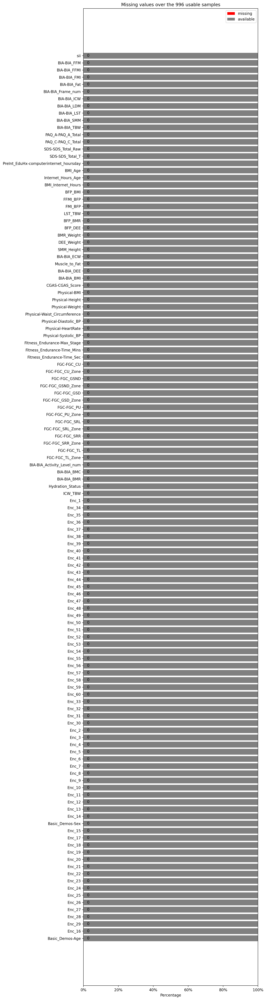

In [223]:
u.missing_values_plot(train_X, "BFP_BMI")

At this stage we have two train datasets, train_X and train_y with 996 instances each, for dependent and independent variables
test_X contains the independent variables for prediction, 20 rows

## Feature Selection

In [226]:
train_X = train_X.drop(columns= "sii")

In [227]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

train_X_scaled = scaler.fit_transform(train_X)
test_X_scaled= scaler.transform(test_X)

In [228]:
train_X = pd.DataFrame(train_X_scaled, columns=train_X.columns, index=train_X.index)
test_X = pd.DataFrame(test_X_scaled, columns=test_X.columns, index=test_X.index)

In [229]:
train_y = pd.DataFrame(train_y, columns=["sii"])

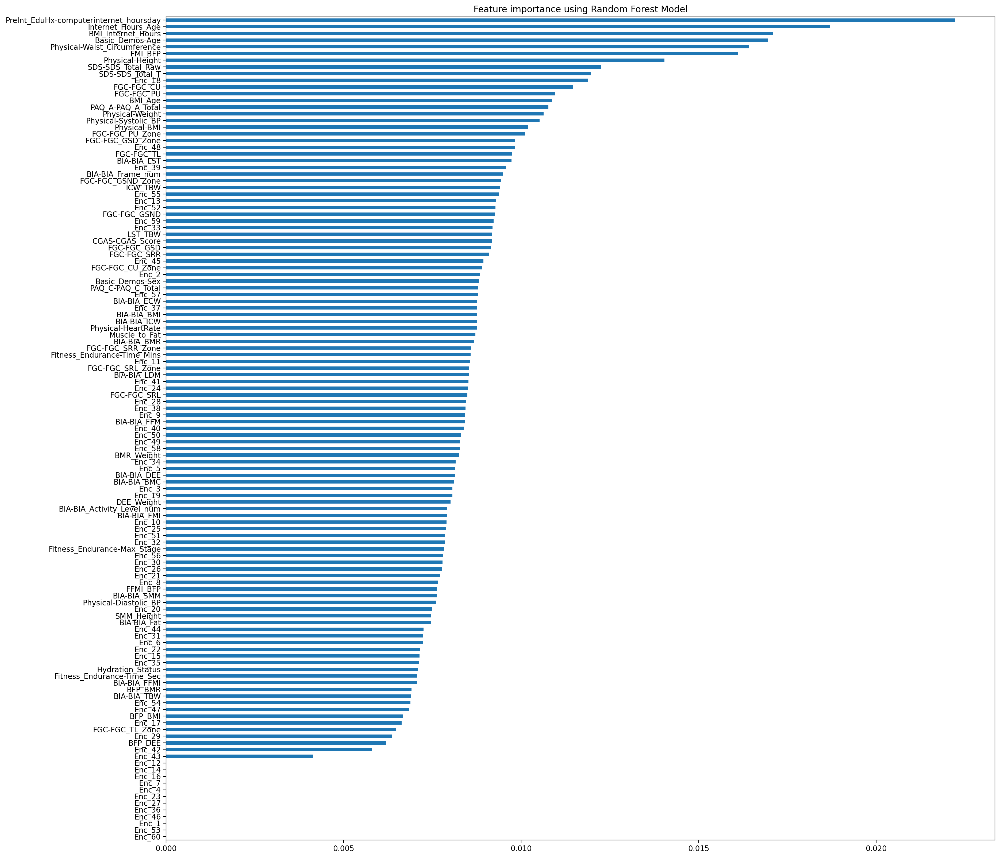

In [230]:
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier


rf_classifier = ExtraTreesClassifier(random_state=15)
rf_classifier.fit(train_X, train_y)

feature_importances = pd.Series(rf_classifier.feature_importances_, index=train_X.columns)

def plot_importance(coef, name):
    imp_coef = coef.sort_values()
    plt.figure(figsize=(20,20))
    imp_coef.plot(kind="barh")
    plt.title("Feature importance using " + name + " Model")
    plt.show()

# Plot the feature importance
plot_importance(feature_importances, 'Random Forest')

In [231]:
pd.set_option('display.max_info_columns', 200)

In [233]:
test_data.info(memory_usage = "deep")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20 entries, 0 to 19
Data columns (total 123 columns):
 #    Column                                  Non-Null Count  Dtype  
---   ------                                  --------------  -----  
 0    Basic_Demos-Age                         20 non-null     float64
 1    Basic_Demos-Sex                         20 non-null     float64
 2    CGAS-CGAS_Score                         20 non-null     float64
 3    Physical-BMI                            20 non-null     float64
 4    Physical-Height                         20 non-null     float64
 5    Physical-Weight                         20 non-null     float64
 6    Physical-Waist_Circumference            20 non-null     float64
 7    Physical-Diastolic_BP                   20 non-null     float64
 8    Physical-HeartRate                      20 non-null     float64
 9    Physical-Systolic_BP                    20 non-null     float64
 10   Fitness_Endurance-Max_Stage             20 non-nul

## Modelling

Evaluation metrics

In [268]:
if np.any(np.isinf(train_X)):
    train_data = train_data.replace([np.inf, -np.inf], np.nan) #replace anything thats infinite with nan

def quadratic_weighted_kappa(y_true, y_pred):
    return cohen_kappa_score(y_true, y_pred, weights='quadratic')

def threshold_Rounder(oof_non_rounded, thresholds):
    return np.where(oof_non_rounded < thresholds[0], 0,
                    np.where(oof_non_rounded < thresholds[1], 1,
                             np.where(oof_non_rounded < thresholds[2], 2, 3)))

def evaluate_predictions(thresholds, y_true, oof_non_rounded):
    rounded_p = threshold_Rounder(oof_non_rounded, thresholds)
    return -quadratic_weighted_kappa(y_true, rounded_p)

In [270]:
import xgboost as xgb

In [272]:
model = xgb.XGBClassifier(
    objective="rank:pairwise", 
    eval_metric="mlogloss",     
    n_estimators=100,
    max_depth=6,
    learning_rate=0.05,
    gamma=0.1,
    min_child_weight=3,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42,
)

In [274]:
model.fit(train_X, train_y)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='mlogloss',
              feature_types=None, gamma=0.1, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.05, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=6,
              max_leaves=None, min_child_weight=3, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=100,
              n_jobs=None, num_parallel_tree=None, objective='multi:softprob', ...)

In [275]:
predictions = model.predict(test_X)

In [276]:
predictions

array([0, 0, 2, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2],
      dtype=int64)

In [286]:
predictions_df = pd.DataFrame(predictions, columns=["sii"])  # Assuming "sii" is the target column name


predictions_df["id"] = test_id.values  # Ensure test_id is also a pandas Series or array

# Reorder columns if necessary to have "id" first and "sii" second
predictions_df = predictions_df[["id", "sii"]]

In [294]:
predictions_df.to_csv("predictions_1.csv")